# Simple Residual GAN

## Configuration

Imports

In [1]:
import math
from collections import defaultdict
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision import datasets, transforms
import torchvision.utils as vision_utils

Configuration

In [2]:
DATA_DIR = "data"

NUM_WORKERS = 4
BATCH_SIZE = 128

IMAGE_SIZE = 128
IMAGE_CHANNELS = 3
NOISE_DIM = 100 # Size of z latent vector
GENERATOR_HIDDEN_CHANNELS = 16
DISCRIMINATOR_HIDDEN_CHANNELS = 16

EPOCHS = 40
LEARNING_RATE_G = 1e-4
WEIGHT_DECAY_G = 1e-1
LEARNING_RATE_D = 1e-4
WEIGHT_DECAY_D = 1e-1
β1 = 0.5

PRINT_FREQ = 500

In [3]:
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

## Utils

In [4]:
def plot_batch(ax, batch, title=None, **kwargs):
    imgs = vision_utils.make_grid(batch, padding=2, normalize=True)
    imgs = np.moveaxis(imgs.numpy(), 0, -1)
    ax.set_axis_off()
    if title is not None: ax.set_title(title)
    return ax.imshow(imgs, **kwargs)

In [5]:
def show_images(batch, title):
    fig = plt.figure(figsize=(8, 8))
    ax = fig.add_subplot(111)
    plot_batch(ax, batch, title)
    plt.show()

## Data

ClebA dataset

In [6]:
transform = transforms.Compose([
    transforms.Resize(IMAGE_SIZE),
    transforms.CenterCrop(IMAGE_SIZE),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

In [7]:
dataset = datasets.ImageFolder(root=DATA_DIR, transform=transform)

In [8]:
dataloader = torch.utils.data.DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=NUM_WORKERS)

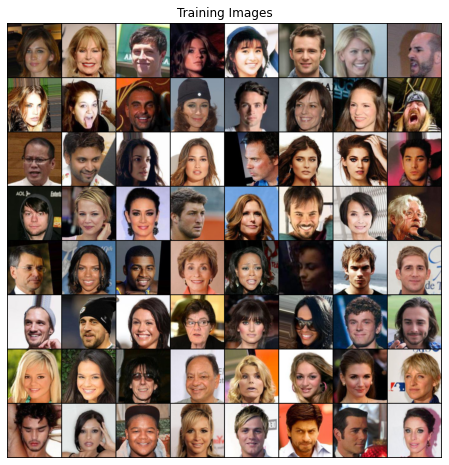

In [9]:
real_batch, _ = next(iter(dataloader))
show_images(real_batch[:64], "Training Images")

## Model

In [10]:
def weights_init(m):
    if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.Linear)):
        nn.init.kaiming_normal_(m.weight)
        if m.bias is not None: nn.init.zeros_(m.bias)
    elif isinstance(m, (nn.BatchNorm2d, nn.InstanceNorm2d, nn.GroupNorm)):
        if m.weight is not None: nn.init.ones_(m.weight)
        if m.bias is not None:nn.init.zeros_(m.bias)

### Generator

InstanceNorm, [arXiv:1607.08022 [cs.CV]](https://arxiv.org/abs/1607.08022)

In [11]:
class PreConvTransposeBlock(nn.Sequential):
    def __init__(self, in_channels, out_channels, kernel_size, stride=1):
        padding = (kernel_size - 1) // 2
        output_padding = stride + 2 * padding - kernel_size
        super().__init__(
            nn.InstanceNorm2d(in_channels, affine=True),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding, output_padding)
        )

In [12]:
class PreConvBlockG(nn.Sequential):
    def __init__(self, in_channels, out_channels, kernel_size, stride=1):
        padding = (kernel_size - 1) // 2
        super().__init__(
            nn.InstanceNorm2d(in_channels, affine=True),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding)
        )

In [13]:
class GeneratorBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.shortcut = nn.Sequential(nn.Upsample(scale_factor=2, mode='nearest'),
                                      nn.Conv2d(in_channels, out_channels, 1))
        self.residual = nn.Sequential(PreConvTransposeBlock(in_channels, out_channels, kernel_size=4, stride=2),
                                      PreConvBlockG(out_channels, out_channels, kernel_size=3))
        self.γ = nn.Parameter(torch.tensor(0.0))
    
    def forward(self, x):
        out = self.shortcut(x) + self.γ * self.residual(x)
        return out

In [14]:
class GeneratorHead(nn.Sequential):
    def __init__(self, in_channels, out_channels):
        super().__init__(
            nn.InstanceNorm2d(in_channels, affine=True),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels, out_channels, 1),
            nn.Tanh()
        )

In [15]:
class Generator(nn.Sequential):
    def __init__(self, noise_dim, hidden_channels, out_channels, num_blocks):
        channels = [hidden_channels * 2**x for x in reversed(range(num_blocks + 1))]
        layers = [nn.ConvTranspose2d(noise_dim, channels[0], kernel_size=4)]
        layers += [GeneratorBlock(c1, c2) for c1, c2 in zip(channels, channels[1:])]
        layers.append(GeneratorHead(channels[-1], out_channels))
        super().__init__(*layers)

In [16]:
generator = Generator(NOISE_DIM, GENERATOR_HIDDEN_CHANNELS, IMAGE_CHANNELS, num_blocks=5).to(DEVICE)

In [17]:
generator.apply(weights_init);

In [18]:
print("Number of generator parameters: {:,}".format(sum(p.numel() for p in generator.parameters())))

Number of generator parameters: 4,577,992


### Discriminator

PatchGAN discriminator, [arXiv:1611.07004 [cs.CV]](https://arxiv.org/abs/1611.07004v3)

In [19]:
class PreConvBlockD(nn.Sequential):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1):
        padding = (kernel_size - 1) // 2
        super().__init__(
            nn.GroupNorm(1, in_channels), # Equivalent to LayerNorm
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels, out_channels, kernel_size, stride=stride, padding=padding)
        )

In [20]:
class DiscriminatorBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.shortcut = nn.Sequential(nn.AvgPool2d(2),
                                      nn.Conv2d(in_channels, out_channels, 1))
        self.residual = nn.Sequential(PreConvBlockD(in_channels, in_channels, kernel_size=3, stride=1),
                                      PreConvBlockD(in_channels, out_channels, kernel_size=4, stride=2))
        self.γ = nn.Parameter(torch.tensor(0.0))
    
    def forward(self, x):
        out = self.shortcut(x) + self.γ * self.residual(x)
        return out

In [21]:
class Discriminator(nn.Sequential):
    def __init__(self, in_channels, hidden_channels, num_blocks):
        channels = [hidden_channels * 2**x for x in range(num_blocks + 1)]
        layers = [nn.Conv2d(in_channels, channels[0], 3, padding=1)]
        layers += [DiscriminatorBlock(c1, c2) for c1, c2 in zip(channels, channels[1:])]
        layers.append(PreConvBlockD(channels[-1], 1, kernel_size=1))
        super().__init__(*layers)

In [22]:
discriminator = Discriminator(IMAGE_CHANNELS, DISCRIMINATOR_HIDDEN_CHANNELS, num_blocks=5).to(DEVICE)

In [23]:
discriminator.apply(weights_init);

In [24]:
print("Number of discriminator parameters: {:,}".format(sum(p.numel() for p in discriminator.parameters())))

Number of discriminator parameters: 3,760,182


## Loss

Hinge loss for GANs, [arXiv:1705.02894 [stat.ML]](https://arxiv.org/abs/1705.02894)

In [25]:
class GANLossHinge:
    @staticmethod
    def D_real(logits):
        return torch.mean(F.relu(1. - logits, inplace=True))
    
    @staticmethod
    def D_fake(logits):
        return torch.mean(F.relu(1. + logits, inplace=True))
    
    @staticmethod
    def G(logits):
        return - torch.mean(logits)

## Training

### Trainer

In [26]:
class Trainer:
    def __init__(self, generator, discriminator, criterion_D_real, criterion_D_fake, criterion_G,
                 optimizer_G, optimizer_D, dataloader, device,
                 batch_scheduler_G=None, batch_scheduler_D=None):
        self.generator = generator
        self.discriminator = discriminator
        self.criterion_D_real = criterion_D_real
        self.criterion_D_fake = criterion_D_fake
        self.criterion_G = criterion_G
        self.optimizer_G = optimizer_G
        self.optimizer_D = optimizer_D
        self.dataloader = dataloader
        self.device = device
        self.batch_scheduler_G = batch_scheduler_G
        self.batch_scheduler_D = batch_scheduler_D
        self.history = defaultdict(list)
        self.fixed_noise = self.get_noise(64)
    
    def get_noise(self, batch_size):
        return torch.randn(batch_size, NOISE_DIM, 1, 1, device=self.device)
    
    def save_fake_images(self):
        with torch.no_grad():
            fake_images = self.generator(self.fixed_noise).detach().cpu()
        self.history['fake_images'].append(fake_images)
    
    
    def update_discriminator(self, real_images):
        self.optimizer_D.zero_grad()
        
        # All-real batch
        output_real = self.discriminator(real_images)
        loss_D_real = self.criterion_D_real(output_real)
        
        # All-fake batch
        batch_size = real_images.size(0)
        noise = self.get_noise(batch_size)
        fake_images = self.generator(noise)
        output_fake = self.discriminator(fake_images.detach())
        loss_D_fake = self.criterion_D_fake(output_fake)

        loss_D = 0.5 * (loss_D_real + loss_D_fake)
        loss_D.backward()
        self.optimizer_D.step()
        
        if self.batch_scheduler_D is not None:
            self.batch_scheduler_D.step()
        
        self.history['loss_D'].append(loss_D.item())
        self.history['logits_real'].append(torch.mean(output_real).item())
        self.history['logits_fake'].append(torch.mean(output_fake).item())
        
        return fake_images
    
    
    def update_generator(self, fake_images):
        self.optimizer_G.zero_grad()
        output_fake_G = self.discriminator(fake_images) # discriminator was updated: output_fake_G not equal to output_fake
        loss_G = self.criterion_G(output_fake_G)
        loss_G.backward()
        self.optimizer_G.step()
        
        if self.batch_scheduler_G is not None:
            self.batch_scheduler_G.step()
        
        self.history['loss_G'].append(loss_G.item())
    
    
    def print_metrics(self, iters, epoch, epochs):
        print('{} [{}/{}]: D loss {:.4f}, G loss {:.4f}, logits real {:.4f}, logits fake {:.4f}'.format(
            iters, epoch+1, epochs, self.history['loss_D'][-1], self.history['loss_G'][-1],
            self.history['logits_real'][-1], self.history['logits_fake'][-1]))
    
    
    def train(self, epochs, print_freq):
        iters = 0
        for epoch in range(epochs):
            for real_images, _ in self.dataloader:
                real_images = real_images.to(self.device)
                 
                fake_images = self.update_discriminator(real_images)
                self.update_generator(fake_images)
                
                if iters % print_freq == 0:
                    self.print_metrics(iters, epoch, epochs)
                    self.save_fake_images()
                iters += 1
        self.save_fake_images()

### Start Training

In [27]:
criterion = GANLossHinge()

In [28]:
optimizer_G = optim.AdamW(generator.parameters(), lr=LEARNING_RATE_G, weight_decay=WEIGHT_DECAY_G, betas=(β1, 0.999))
optimizer_D = optim.AdamW(discriminator.parameters(), lr=LEARNING_RATE_D, weight_decay=WEIGHT_DECAY_D, betas=(β1, 0.999))

In [29]:
lr_scheduler_G = optim.lr_scheduler.OneCycleLR(optimizer_G, max_lr=LEARNING_RATE_G,
                                               steps_per_epoch=len(dataloader), epochs=EPOCHS, cycle_momentum=False)

lr_scheduler_D = optim.lr_scheduler.OneCycleLR(optimizer_D, max_lr=LEARNING_RATE_D,
                                               steps_per_epoch=len(dataloader), epochs=EPOCHS, cycle_momentum=False)

In [30]:
trainer = Trainer(generator, discriminator,
                  criterion.D_real, criterion.D_fake, criterion.G,
                  optimizer_G, optimizer_D, dataloader, DEVICE,
                  lr_scheduler_G, lr_scheduler_D)

In [35]:
trainer.train(EPOCHS, PRINT_FREQ)

0 [1/40]: D loss 0.9989, G loss 0.3954, logits real -0.3282, logits fake -0.3912
500 [1/40]: D loss 0.7014, G loss 0.2357, logits real 0.4687, logits fake -0.2347
1000 [1/40]: D loss 0.5863, G loss 0.4419, logits real 0.4525, logits fake -0.4432
1500 [1/40]: D loss 0.3566, G loss 0.8974, logits real 0.9940, logits fake -0.8913
2000 [2/40]: D loss 0.1845, G loss 1.3546, logits real 2.0549, logits fake -1.2681
2500 [2/40]: D loss 0.1481, G loss 1.4282, logits real 2.4298, logits fake -1.3870
3000 [2/40]: D loss 0.2417, G loss 1.0233, logits real 2.5179, logits fake -1.4250
3500 [3/40]: D loss 0.3093, G loss 0.9324, logits real 2.0659, logits fake -1.4532
4000 [3/40]: D loss 0.2683, G loss 1.3177, logits real 2.7029, logits fake -1.1631
4500 [3/40]: D loss 0.4232, G loss 0.6033, logits real 1.2999, logits fake -1.8271
5000 [4/40]: D loss 0.5720, G loss 0.5053, logits real 0.6629, logits fake -1.6923
5500 [4/40]: D loss 0.4714, G loss 1.3494, logits real 1.7170, logits fake -0.5421
6000 [4

## Plotting

In [32]:
def plot_losses(G_losses, D_losses):
    fig = plt.figure(figsize=(10, 5))
    ax = fig.add_subplot(111)
    
    iters = np.arange(1, len(G_losses) + 1)
    ax.scatter(iters, G_losses, marker='.', label="Generator")
    ax.scatter(iters, D_losses, marker='.',  label="Discriminator")
    
    ax.set_xlabel("Iterations")
    ax.set_ylabel("Loss")
    ax.set_title("Generator and Discriminator Loss During Training")
    ax.legend()
    plt.show()

In [33]:
def animate_progress(img_list):
    fig = plt.figure(figsize=(8, 8))
    ax = fig.add_subplot(111)
    ax.set_axis_off()
    frames = [[plot_batch(ax, batch, animated=True)] for batch in img_list]
    ani = animation.ArtistAnimation(fig, frames, interval=1000, repeat_delay=1000, blit=True)
    plt.close()
    return ani

In [34]:
def show_fake_batch(fixed_noise):
    with torch.no_grad():
        fake_batch = generator(fixed_noise).detach().cpu()
    show_images(fake_batch, "Generated Images")

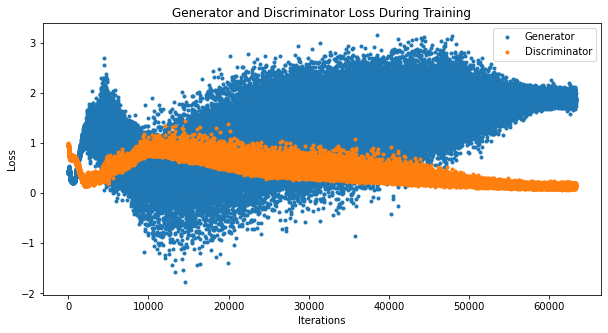

In [39]:
plot_losses(trainer.history['loss_G'], trainer.history['loss_D'])

In [37]:
ani = animate_progress(trainer.history['fake_images'][:32])
HTML(ani.to_jshtml())

In [38]:
generator.eval();

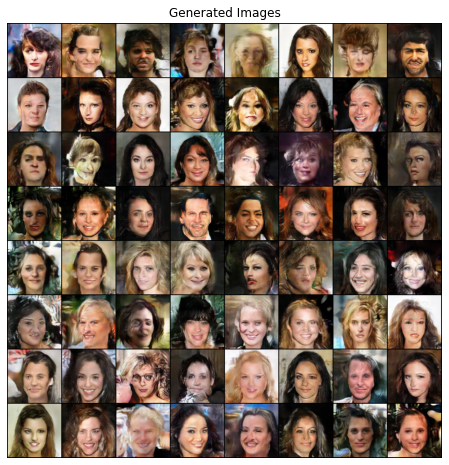

In [42]:
show_fake_batch(trainer.fixed_noise)